<a href="https://colab.research.google.com/github/neeti865/GenAI-ImageGen/blob/main/Stable_Diffusion_P1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Stable Diffusion





**`[ ! Attention ]`** It is important to check the license of the models, especially if you intend to make some commercial use with the obtained results.

Summary:

```
1. You can't use the model to deliberately produce nor share illegal or harmful outputs or content,
2. We claim no rights on the outputs you generate, you are free to use them and are accountable for their use which should not go against the provisions set in the license, and
3. You may re-distribute the weights and use the model commercially and/or as a service. If you do, please be aware you have to include the same use restrictions as the ones in the license and share a copy of the CreativeML OpenRAIL-M to all your users.
```
(Licence of v1.4 e v1.5 https://huggingface.co/spaces/CompVis/stable-diffusion-license)


In [1]:
!nvidia-smi

Mon Mar 11 04:31:21 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   64C    P8              11W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

## Installing the libraries

- [xformers](https://github.com/facebookresearch/xformers) to memory optimization

> Update: At this moment there is an incompatibility between xFormers and the most recent versions of the Pytorch library, which have recently been attributed to the new sessions in Colab. Therefore, our recommendation is to downgrade torch to version 1.13.1, as currently xformers works best for this version.



In [2]:
!pip install torch==2.1.0+cu121 torchvision==0.16.0+cu121 torchaudio==2.1.0 torchtext==0.16.0+cpu torchdata==0.7.0 --index-url https://download.pytorch.org/whl/cu121

Looking in indexes: https://download.pytorch.org/whl/cu121
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 36.9 MB/s eta 0:00:00
  Attempting uninstall: torchtext
    Found existing installation: torchtext 0.16.0
    Uninstalling torchtext-0.16.0:
      Successfully uninstalled torchtext-0.16.0


In [3]:
!pip install diffusers
!pip install -q accelerate transformers ftfy bitsandbytes gradio natsort safetensors xformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 8.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 280.0/280.0 kB 4.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.4/53.4 kB 6.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.2/102.2 MB 2.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.0/17.0 MB 71.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 218.2/218.2 MB 5.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 92.1/92.1 kB 13.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 310.7/310.7 kB 34.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.6/75.6 kB 11.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 138.5/138.5 kB 17.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.9/7.9 MB 96.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.6/60.6 kB 8.9 MB/s

## Pipeline for image generation

- We can define with little effort a pipeline to use the Stable Diffusion model, through the [StableDiffusionPipeline](https://github.com/huggingface/diffusers/blob/main/src/diffusers/pipelines/stable_diffusion/pipeline_stable_diffusion.py)


In [4]:
import torch #PyTorch
from diffusers import StableDiffusionPipeline

/usr/local/lib/python3.10/dist-packages/diffusers/utils/outputs.py:63: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/diffusers/utils/outputs.py:63: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
/usr/local/lib/python3.10/dist-packages/diffusers/utils/outputs.py:63: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(


In [5]:
pipe = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4", torch_dtype=torch.float16)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

(…)kpoints/scheduler_config-checkpoint.json:   0%|          | 0.00/209 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/313 [00:00<?, ?B/s]

safety_checker/config.json:   0%|          | 0.00/4.56k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/551 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [6]:
pipe = pipe.to('cuda')

In [7]:
pipe.enable_attention_slicing()
pipe.enable_xformers_memory_efficient_attention()

### Creating the prompt

In [8]:
prompt = 'an apple'

### Generating the image



In [9]:
img = pipe(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

In [10]:
type(img)

PIL.Image.Image

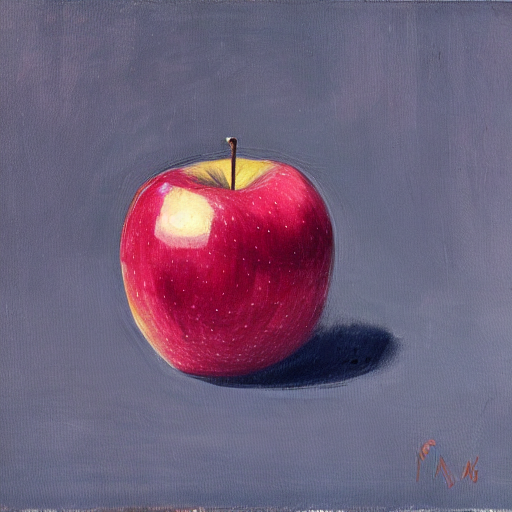

In [11]:
img

  0%|          | 0/50 [00:00<?, ?it/s]

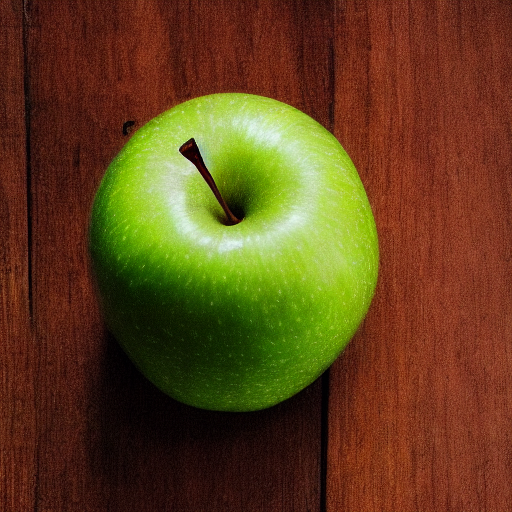

In [12]:
prompt = 'photograph of a green apple'
img = pipe(prompt).images[0]
img

### Saving the result

In [13]:
img.save('result.png')

  0%|          | 0/50 [00:00<?, ?it/s]

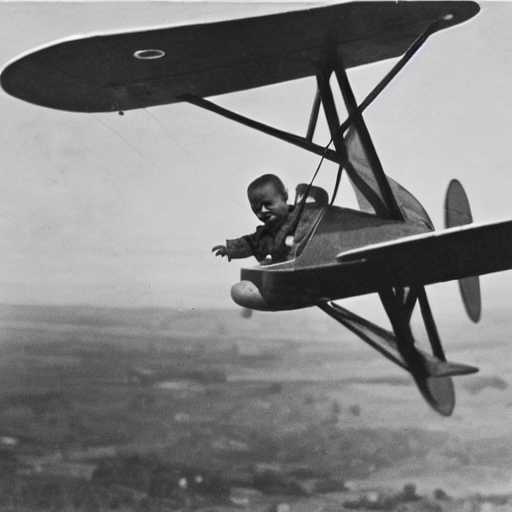

In [14]:
prompt = 'a photograph of a baby flying an aeroplane, color'
img = pipe(prompt).images[0]
img

In [15]:
img.size

(512, 512)

## Generating multiple images

In [16]:
0.75 * 512

384.0

In [17]:
from PIL import Image

def grid_img(imgs, rows=1, cols=3, scale=1):
  assert len(imgs) == rows * cols

  w, h = imgs[0].size
  w, h = int(w * scale), int(h * scale)

  grid = Image.new('RGB', size = (cols * w, rows * h))
  grid_w, grid_h = grid.size

  for i, img in enumerate(imgs):
    img = img.resize((w, h), Image.ANTIALIAS)
    grid.paste(img, box=(i % cols * w, i // cols * h))
  return grid

  0%|          | 0/50 [00:00<?, ?it/s]

<ipython-input-17-8b3b91ba0ae1>:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w, h), Image.ANTIALIAS)


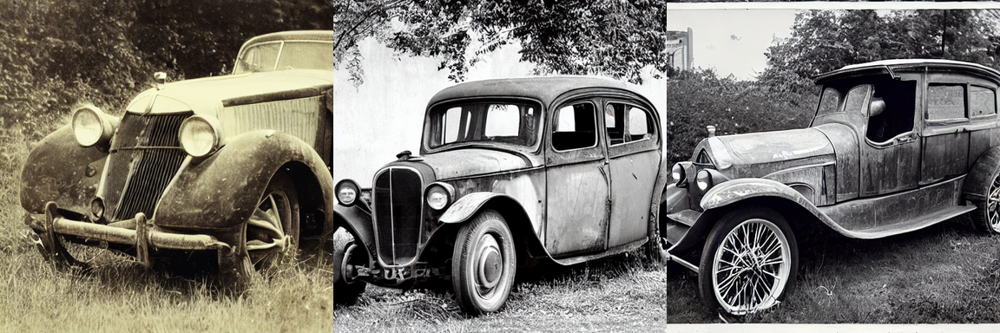

In [18]:
num_imgs = 3
prompt = 'photograph of an old car'
imgs = pipe(prompt, num_images_per_prompt=num_imgs).images
grid = grid_img(imgs, rows=1, cols=3, scale=0.75)
grid

## Parameters

### Seed




  0%|          | 0/50 [00:00<?, ?it/s]

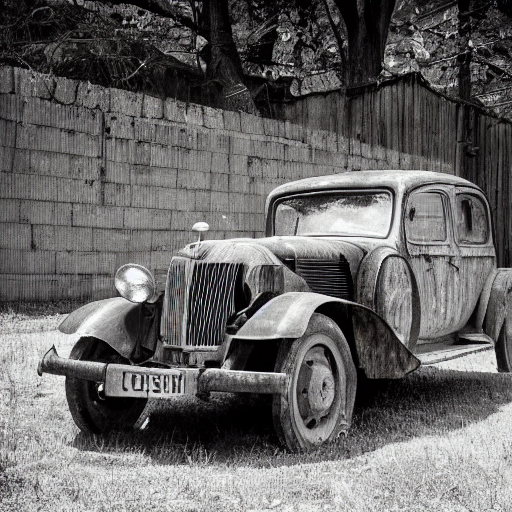

In [31]:
seed = 777
generator = torch.Generator('cuda').manual_seed(seed)
img = pipe(prompt, generator=generator).images[0]
img

  0%|          | 0/50 [00:00<?, ?it/s]

<ipython-input-17-8b3b91ba0ae1>:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w, h), Image.ANTIALIAS)


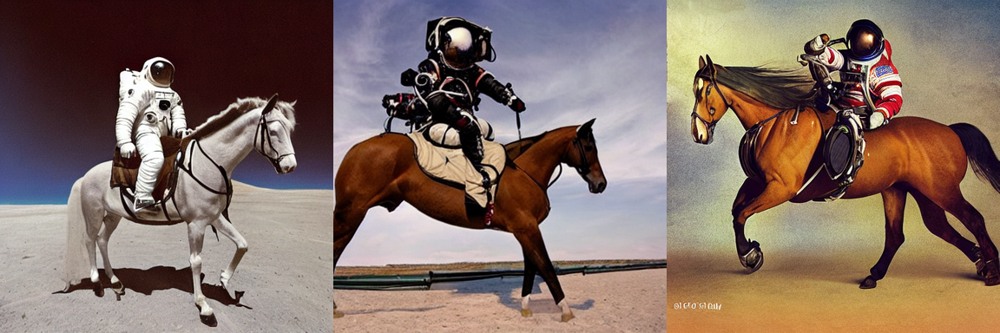

In [32]:
prompt = "a photograph of an astronaut riding a horse"
seed = 777
generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompt, num_images_per_prompt=num_imgs, generator=generator).images
grid = grid_img(imgs, rows=1, cols=3, scale=0.75)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

<ipython-input-17-8b3b91ba0ae1>:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w, h), Image.ANTIALIAS)


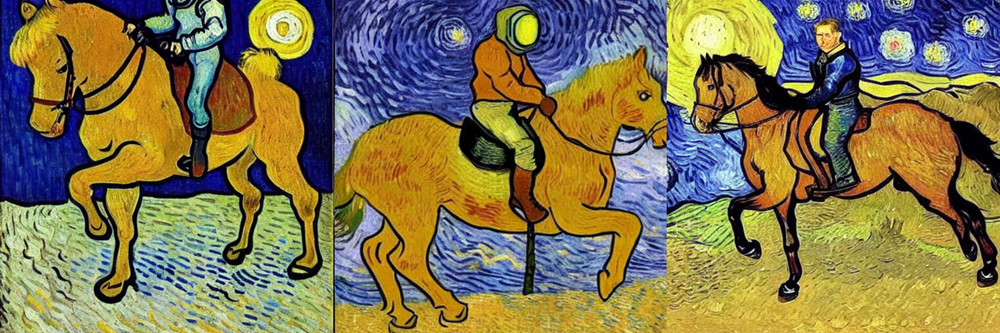

In [21]:
prompt = "van gogh painting of an astronaut riding a horse"
generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompt, num_images_per_prompt=num_imgs, generator=generator).images
grid = grid_img(imgs, rows=1, cols=3, scale=0.75)
grid

### Inference steps

  0%|          | 0/20 [00:00<?, ?it/s]

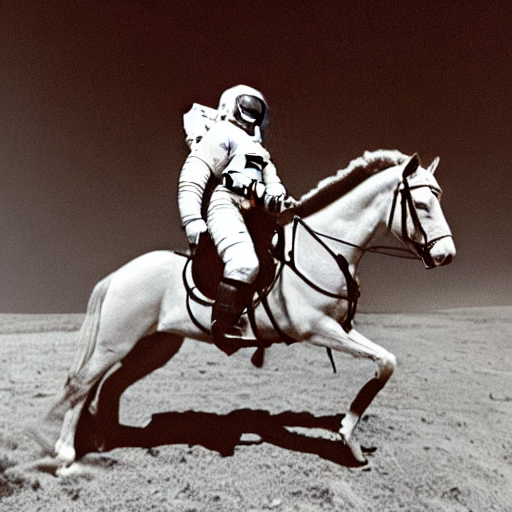

In [33]:
prompt = "a photograph of an astronaut riding a horse"
generator = torch.Generator("cuda").manual_seed(seed)
img = pipe(prompt, num_inference_steps=20, generator=generator).images[0]
img

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

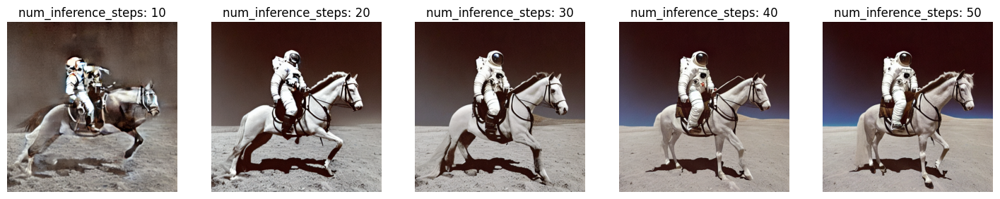

In [34]:
import matplotlib.pyplot as plt

plt.figure(figsize=(18,8))
for i in range(1, 6):
  n_steps = i * 10
  #print(n_steps)
  generator = torch.Generator('cuda').manual_seed(seed)
  img = pipe(prompt, num_inference_steps=n_steps, generator=generator).images[0]

  plt.subplot(1, 5, i)
  plt.title('num_inference_steps: {}'.format(n_steps))
  plt.imshow(img)
  plt.axis('off')
plt.show()

### Guidance scale (CFG)

Choosing the best value

* Values between 7 and 8.5 are generally good choices. The default value is 7.5

* In general, you can keep the value in the range from 5 to 9. Less realistic images will be returned if the values are too low or too high

* The best value depends on the desired results and the complexity of the prompt

  0%|          | 0/50 [00:00<?, ?it/s]

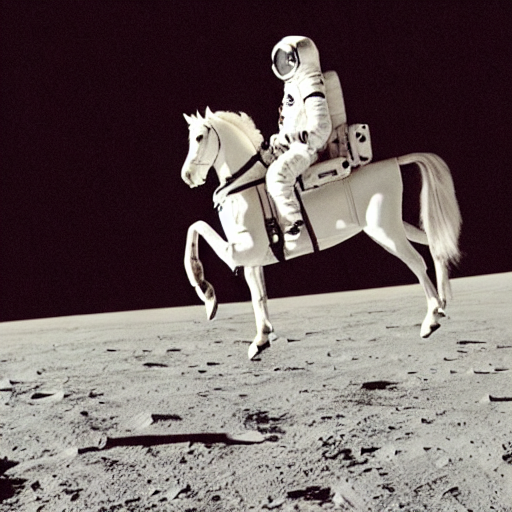

In [35]:
prompt = "a photograph of an astronaut riding a horse"

generator = torch.Generator("cuda").manual_seed(seed)
img = pipe(prompt, guidance_scale=10, generator=generator).images[0]
img

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

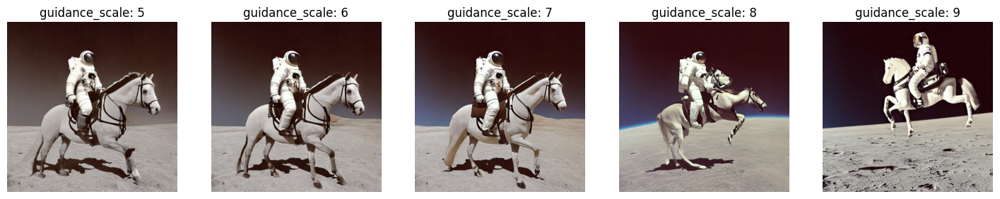

In [36]:
plt.figure(figsize=(18,8))
for i in range(1, 6):

  n_guidance = i + 4
  generator = torch.Generator("cuda").manual_seed(seed)
  img = pipe(prompt, guidance_scale=n_guidance, generator=generator).images[0]

  plt.subplot(1,5,i)
  plt.title('guidance_scale: {}'.format(n_guidance))
  plt.imshow(img)
  plt.axis('off')

plt.show()

### Image size (dimensions)

The generated images are 512 x 512 pixels

Recommendations in case you want other dimensions:

* make sure the height and width are multiples of 8
* less than 512 will result in lower quality images
* exceeding 512 in both directions (width and height) will repeat areas of the image ("global coherence" is lost)

> Landscape mode


  0%|          | 0/50 [00:00<?, ?it/s]

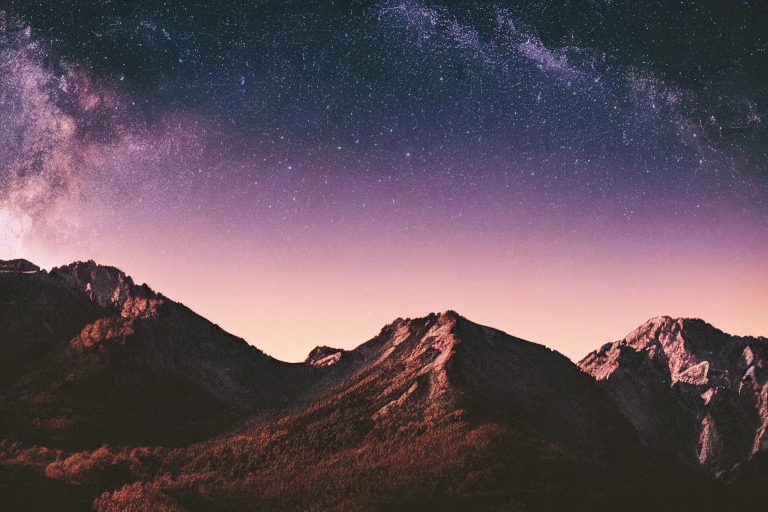

In [37]:
seed = 777
prompt = "photograph of a mountain landscape during sunset, stars in the sky"
generator = torch.Generator("cuda").manual_seed(seed)
h, w = 512, 768
img = pipe(prompt, height=h, width=w, generator=generator).images[0]
img

> Portrait mode



  0%|          | 0/50 [00:00<?, ?it/s]

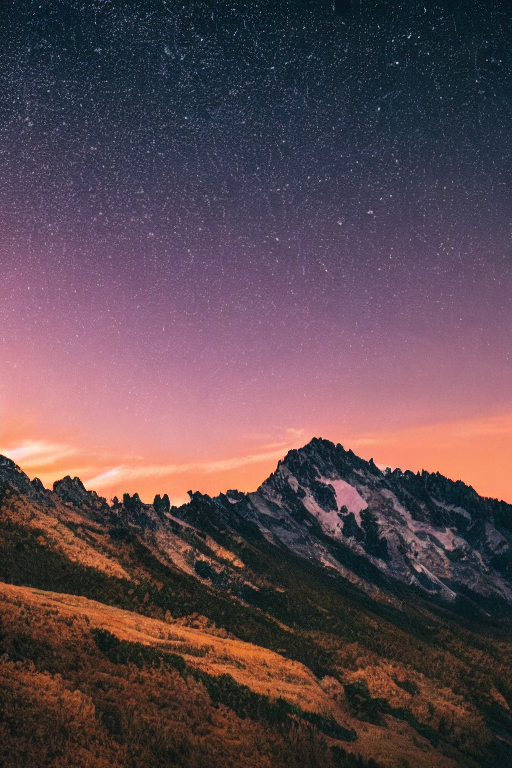

In [38]:
generator = torch.Generator("cuda").manual_seed(seed)
h, w = 768, 512
img = pipe(prompt, height=h, width=w, generator=generator).images[0]
img

### Negative prompt

  0%|          | 0/50 [00:00<?, ?it/s]

<ipython-input-17-8b3b91ba0ae1>:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w, h), Image.ANTIALIAS)


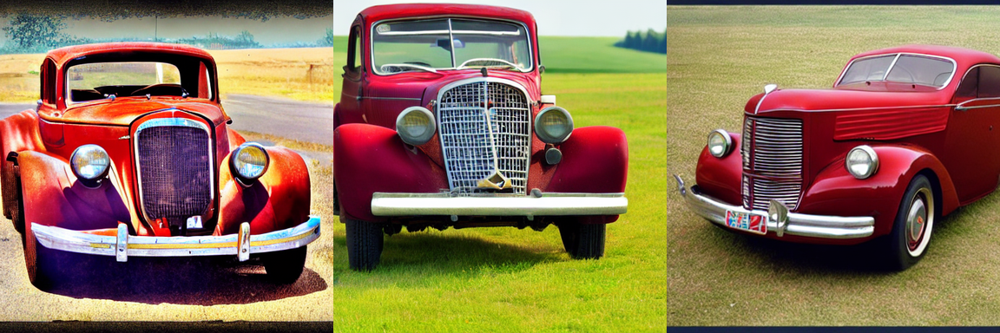

In [39]:
num_images = 3

prompt = 'photograph of an old car'
neg_prompt = 'bw photo'

imgs = pipe(prompt, negative_prompt = neg_prompt, num_images_per_prompt=num_images).images

grid = grid_img(imgs, rows = 1, cols = 3, scale=0.75)
grid

## Other models

### SD v1.5

In [40]:
sd15 = StableDiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16)
sd15 = sd15.to('cuda')
sd15.enable_attention_slicing()
sd15.enable_xformers_memory_efficient_attention()

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

<ipython-input-17-8b3b91ba0ae1>:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w, h), Image.ANTIALIAS)


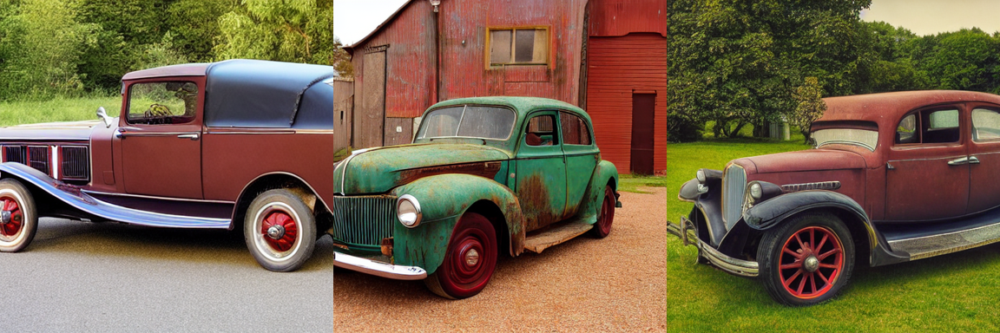

In [41]:
num_imgs = 3

prompt = "photograph of an old car"
neg_prompt = "bw photo"

imgs = sd15(prompt, negative_prompt=neg_prompt, num_images_per_prompt=num_imgs).images

grid = grid_img(imgs, rows=1, cols=3, scale=0.75)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

<ipython-input-17-8b3b91ba0ae1>:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w, h), Image.ANTIALIAS)


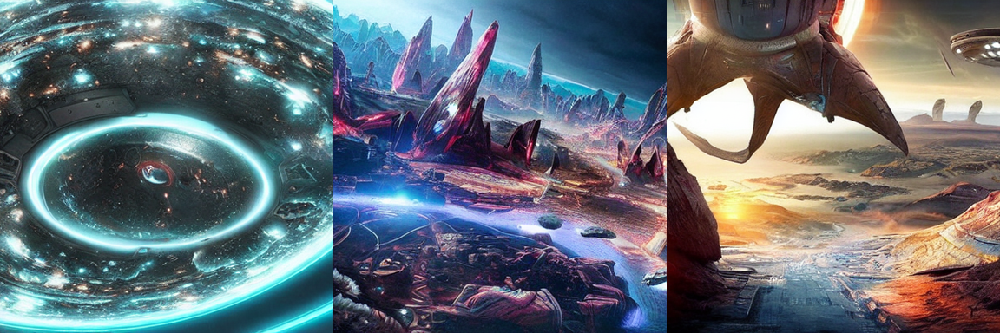

In [42]:
prompt = "photo of a futuristic city on another planet, realistic, full hd"
neg_prompt = 'buildings'

imgs = sd15(prompt, negative_prompt = neg_prompt, num_images_per_prompt=num_imgs).images

grid = grid_img(imgs, rows=1, cols=3, scale=0.75)
grid

### SD v2.x

In [43]:
sd2 = StableDiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-2-1", torch_dtype=torch.float16)
sd2 = sd2.to("cuda")
sd2.enable_attention_slicing()
sd2.enable_xformers_memory_efficient_attention()

model_index.json:   0%|          | 0.00/537 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/633 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/824 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/345 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/939 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.36G [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/611 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.46G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

<ipython-input-17-8b3b91ba0ae1>:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w, h), Image.ANTIALIAS)


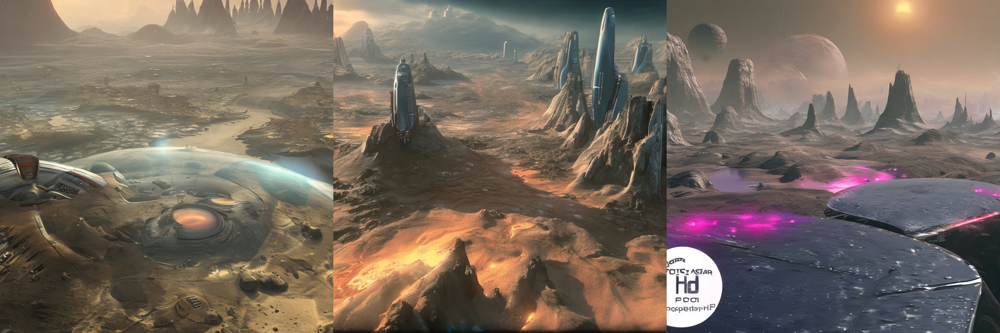

In [44]:
prompt = "photo of a futuristic city on another planet, realistic, full hd"
neg_prompt = 'buildings'

imgs = sd2(prompt, negative_prompt=neg_prompt, num_images_per_prompt=num_imgs).images

grid = grid_img(imgs, rows=1, cols=3, scale=0.75)
grid

### Fine-tuned models with specific styles

> Mo-di-diffusion (Modern Disney style)

https://huggingface.co/nitrosocke/mo-di-diffusion



In [45]:
modi = StableDiffusionPipeline.from_pretrained("nitrosocke/mo-di-diffusion", torch_dtype=torch.float16)
modi = modi.to("cuda")
modi.enable_attention_slicing()
modi.enable_xformers_memory_efficient_attention()

model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

safety_checker/model.safetensors not found


Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

scheduler/scheduler_config.json:   0%|          | 0.00/308 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

safety_checker/config.json:   0%|          | 0.00/4.84k [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/576 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/492M [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

<ipython-input-17-8b3b91ba0ae1>:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w, h), Image.ANTIALIAS)


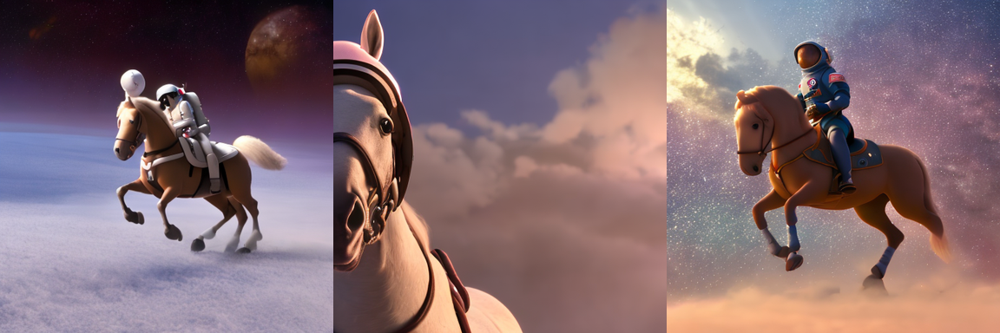

In [46]:
prompt = "a photograph of an astronaut riding a horse, modern disney style"

seed = 777
generator = torch.Generator("cuda").manual_seed(seed)

imgs = modi(prompt, generator=generator, num_images_per_prompt=num_imgs).images

grid = grid_img(imgs, rows=1, cols=3, scale=0.75)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

<ipython-input-17-8b3b91ba0ae1>:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w, h), Image.ANTIALIAS)


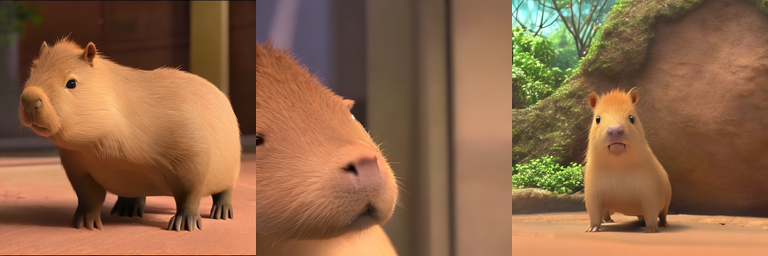

In [47]:
prompt = "capybara, modern disney style"

generator = torch.Generator("cuda").manual_seed(seed)
imgs = modi(prompt, generator=generator, num_images_per_prompt=3).images

grid = grid_img(imgs, rows=1, cols=3, scale=0.5)
grid

Seed: 


  0%|          | 0/50 [00:00<?, ?it/s]

<ipython-input-17-8b3b91ba0ae1>:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w, h), Image.ANTIALIAS)


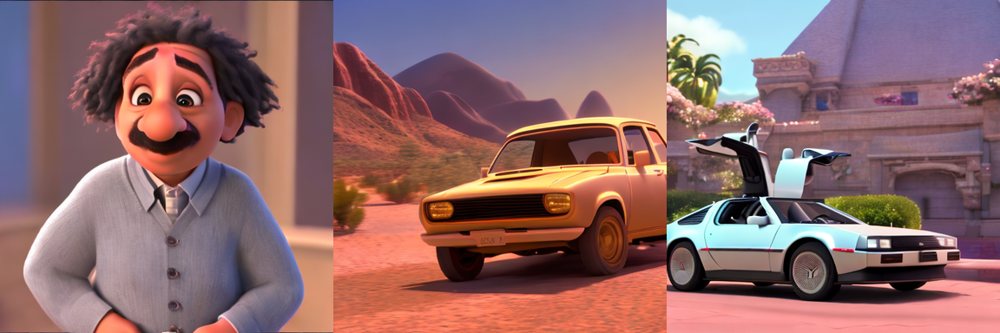

In [48]:
prompt = ["albert einstein, modern disney style",
          "modern disney style old chevette driving in the desert, golden hour",
          "modern disney style delorean"]

seed = 777
print("Seed: ".format(str(seed)))
generator = torch.Generator("cuda").manual_seed(seed)
imgs = modi(prompt, generator=generator).images

grid = grid_img(imgs, rows=1, cols=3, scale=0.75)
grid

#### Other models

* Classic Disney Style - https://huggingface.co/nitrosocke/classic-anim-diffusion

* High resolution 3D animation - https://huggingface.co/nitrosocke/redshift-diffusion

* Futuristic images - https://huggingface.co/nitrosocke/Future-Diffusion

* Other animation styles:
 * https://huggingface.co/nitrosocke/Ghibli-Diffusion
 * https://huggingface.co/nitrosocke/spider-verse-diffusion
* more models https://huggingface.co/models?other=stable-diffusion-diffusers

## Changing the scheduler (sampler)

- Available schedulers:
https://huggingface.co/docs/diffusers/using-diffusers/schedulers#schedulers-summary


Default is [PNDMScheduler](https://github.com/huggingface/diffusers/blob/main/src/diffusers/schedulers/scheduling_pndm.py).


In [49]:
sd15 = StableDiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16)
sd15 = sd15.to("cuda")
sd15.enable_attention_slicing()
sd15.enable_xformers_memory_efficient_attention()

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [50]:
sd15.scheduler

PNDMScheduler {
  "_class_name": "PNDMScheduler",
  "_diffusers_version": "0.26.3",
  "beta_end": 0.012,
  "beta_schedule": "scaled_linear",
  "beta_start": 0.00085,
  "clip_sample": false,
  "num_train_timesteps": 1000,
  "prediction_type": "epsilon",
  "set_alpha_to_one": false,
  "skip_prk_steps": true,
  "steps_offset": 1,
  "timestep_spacing": "leading",
  "trained_betas": null
}

  0%|          | 0/50 [00:00<?, ?it/s]

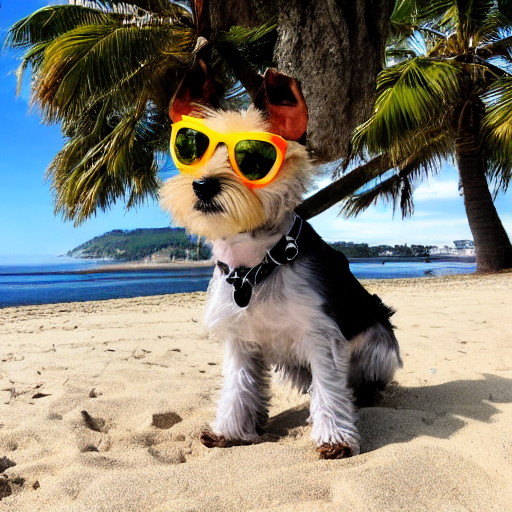

In [51]:
seed = 777
prompt = "a photo of a terrier wearing sunglasses, on the beach, ocean in the background"
generator = torch.Generator('cuda').manual_seed(seed)
img = sd15(prompt, generator=generator).images[0]
img

In [ ]:
sd15.scheduler.compatibles

[diffusers.schedulers.scheduling_dpmsolver_multistep.DPMSolverMultistepScheduler,
 diffusers.schedulers.scheduling_pndm.PNDMScheduler,
 diffusers.schedulers.scheduling_lms_discrete.LMSDiscreteScheduler,
 diffusers.schedulers.scheduling_dpmsolver_singlestep.DPMSolverSinglestepScheduler,
 diffusers.schedulers.scheduling_heun_discrete.HeunDiscreteScheduler,
 diffusers.schedulers.scheduling_euler_ancestral_discrete.EulerAncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_ddim.DDIMScheduler,
 diffusers.schedulers.scheduling_ddpm.DDPMScheduler,
 diffusers.schedulers.scheduling_euler_discrete.EulerDiscreteScheduler]

In [ ]:
sd15.scheduler.config

FrozenDict([('num_train_timesteps', 1000),
            ('beta_start', 0.00085),
            ('beta_end', 0.012),
            ('beta_schedule', 'scaled_linear'),
            ('trained_betas', None),
            ('skip_prk_steps', True),
            ('set_alpha_to_one', False),
            ('prediction_type', 'epsilon'),
            ('steps_offset', 1),
            ('_class_name', 'PNDMScheduler'),
            ('_diffusers_version', '0.11.1'),
            ('clip_sample', False)])

In [ ]:
from diffusers import DDIMScheduler
sd15.scheduler = DDIMScheduler.from_config(sd15.scheduler.config)

  0%|          | 0/50 [00:00<?, ?it/s]

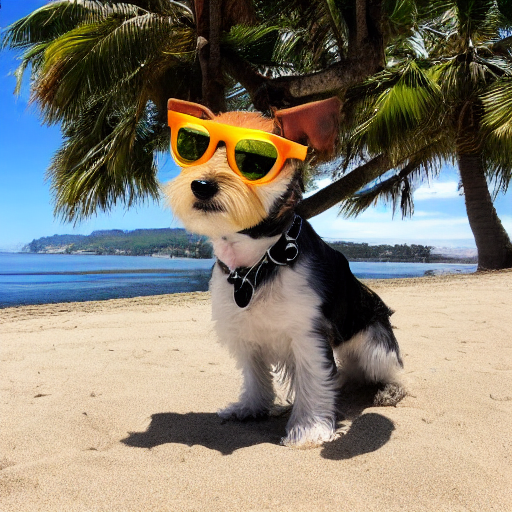

In [ ]:
generator = torch.Generator(device = 'cuda').manual_seed(seed)
img = sd15(prompt, generator=generator).images[0]
img

  0%|          | 0/60 [00:00<?, ?it/s]

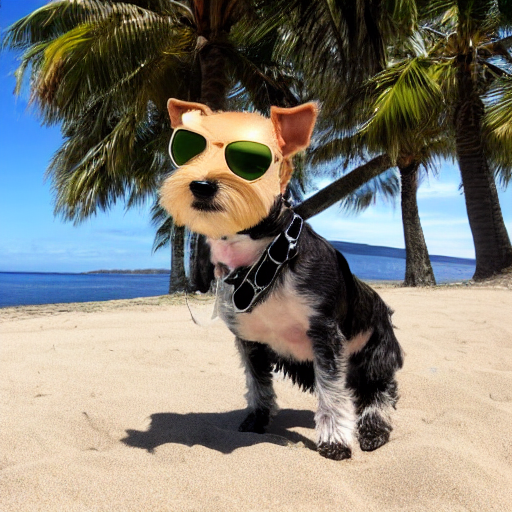

In [ ]:
from diffusers import LMSDiscreteScheduler
sd15.scheduler = LMSDiscreteScheduler.from_config(sd15.scheduler.config)
generator = torch.Generator(device = 'cuda').manual_seed(seed)
img = sd15(prompt, num_inference_steps = 60, generator=generator).images[0]
img

  0%|          | 0/50 [00:00<?, ?it/s]

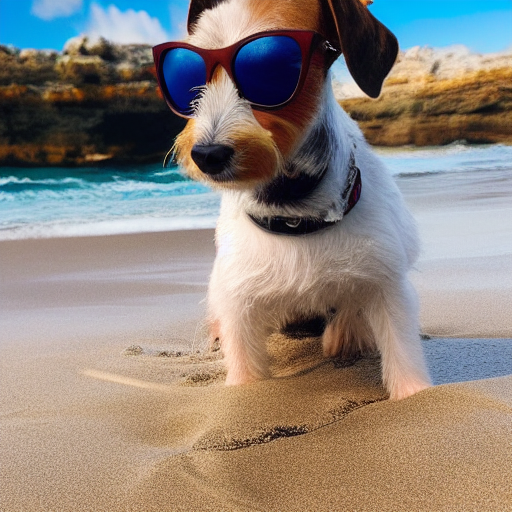

In [ ]:
from diffusers import EulerAncestralDiscreteScheduler

sd15.scheduler = EulerAncestralDiscreteScheduler.from_config(pipe.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(seed)
img = sd15(prompt, generator=generator, num_inference_steps=50).images[0]
img

  0%|          | 0/50 [00:00<?, ?it/s]

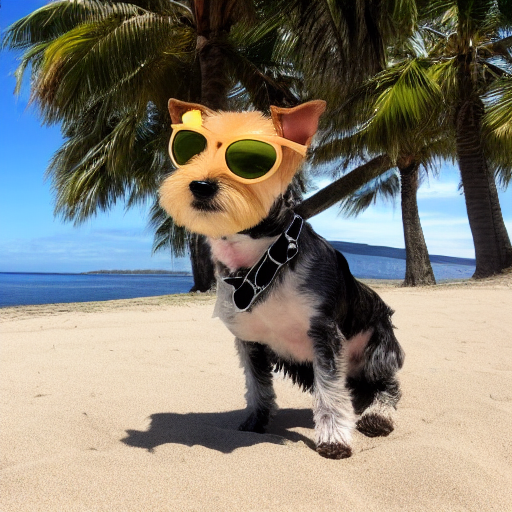

In [ ]:
from diffusers import EulerDiscreteScheduler

sd15.scheduler = EulerDiscreteScheduler.from_config(pipe.scheduler.config)

generator = torch.Generator(device="cuda").manual_seed(seed)
img = sd15(prompt, generator=generator, num_inference_steps=50).images[0]
img